In [2]:
## Importing packages

import pandas as pd # data processing
import numpy as np # working with arrays
from termcolor import colored as cl # text customization

from sklearn.metrics import roc_curve, precision_recall_curve, auc,roc_auc_score,average_precision_score

import matplotlib.pyplot as plt 
import seaborn as sns
%matplotlib inline



Importing the data

In [3]:
from pathlib import Path

#path = Path('C:\\')/'Users'/'prach'/'Desktop'/'Rutgers'/'AML'/'project'/'creditcard.csv'

df = pd.read_csv("D:/Rutgers Fall 2021/Algo ML/Credit Card/creditcard.csv")
print(df.head())

   Time        V1        V2        V3        V4        V5        V6        V7  \
0   0.0 -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1   0.0  1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2   1.0 -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3   1.0 -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4   2.0 -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   

         V8        V9  ...       V21       V22       V23       V24       V25  \
0  0.098698  0.363787  ... -0.018307  0.277838 -0.110474  0.066928  0.128539   
1  0.085102 -0.255425  ... -0.225775 -0.638672  0.101288 -0.339846  0.167170   
2  0.247676 -1.514654  ...  0.247998  0.771679  0.909412 -0.689281 -0.327642   
3  0.377436 -1.387024  ... -0.108300  0.005274 -0.190321 -1.175575  0.647376   
4 -0.270533  0.817739  ... -0.009431  0.798278 -0.137458  0.141267 -0.206010   

        V26       V27       V28 

Visualzing the features

<function matplotlib.pyplot.show(close=None, block=None)>

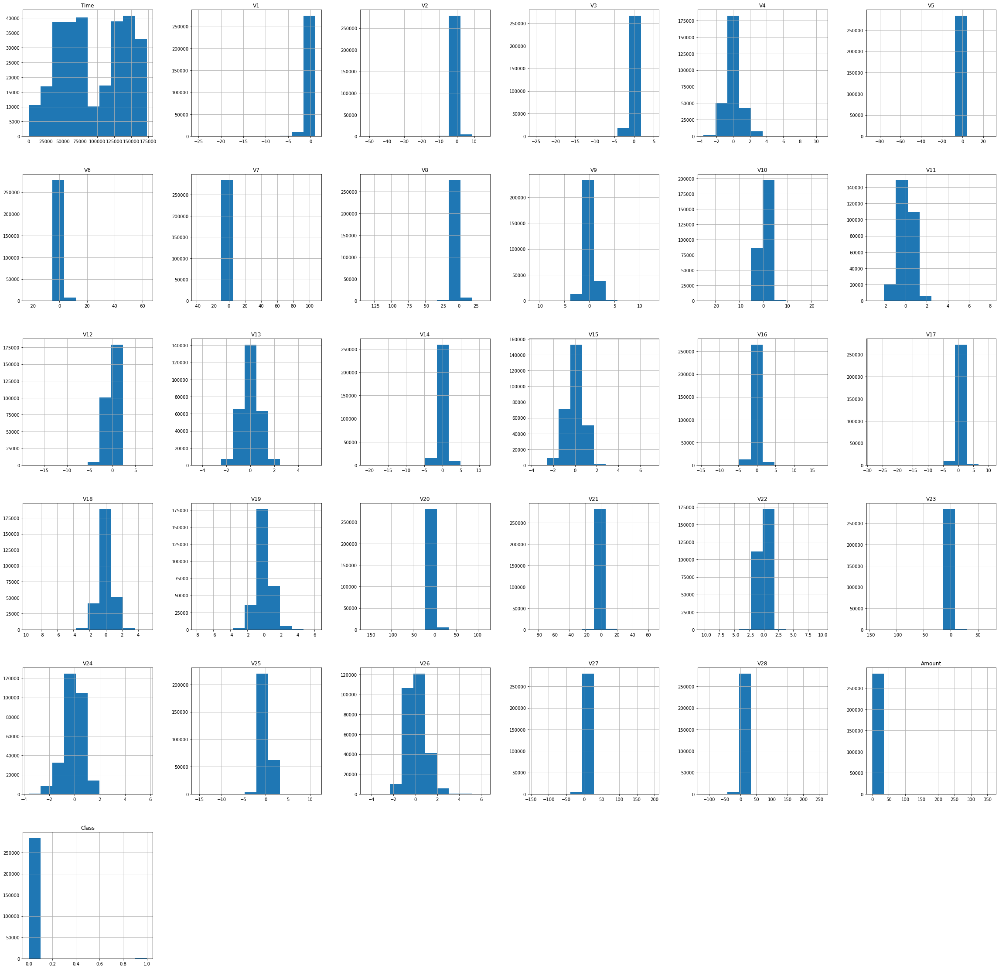

In [75]:
df.hist(figsize = (40,40))
plt.show

Correlation between transaction sizes and fraud cases.

Text(0.5, 0.98, 'Transaction Amount over Time')

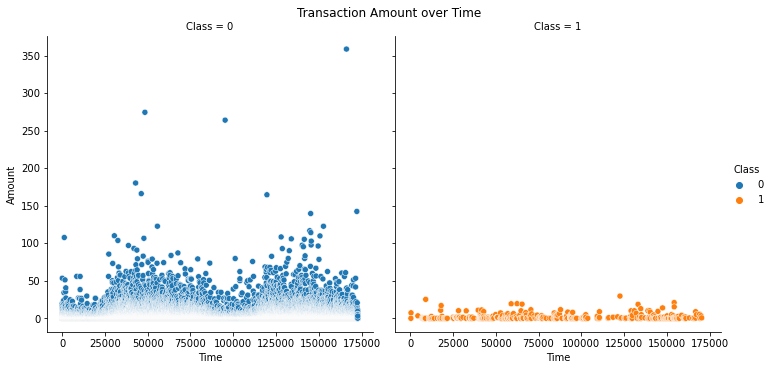

In [86]:
import seaborn as sns
corr = sns.relplot(data = df, x = df['Time'], y = df['Amount'], col = "Class", kind = "scatter", hue = "Class")
corr.fig.subplots_adjust(top = 0.9)
corr.fig.suptitle("Transaction Amount over Time")

The scatterplot provides the insight that suspicious amounts tend to be relatively low. In other words, there is some inverse correlation between class and transaction amount.

Data Processing and EDA

In [3]:
cases = len(df)
print("Total number of cases are: ", cases)
nonfraud_count = len(df[df.Class == 0])
fraud_count = len(df[df.Class == 1])
print("Non fraud Count: ", nonfraud_count)
print("Fraud Count: ",fraud_count)
fraud_percentage = round(fraud_count/nonfraud_count *100,2)
print("Percentage of fraud cases is: ", fraud_percentage)

Total number of cases are:  284807
Non fraud Count:  284315
Fraud Count:  492
Percentage of fraud cases is:  0.17


Summary of Cases

In [4]:
nonfraud_cases = df[df.Class == 0]
fraud_cases = df[df.Class == 1]
print(cl("Non Fraud Cases Summary: ",attrs = ['bold']))
print(nonfraud_cases.Amount.describe())
print(cl("Fraud Cases Summary: ",attrs = ['bold']))
print(fraud_cases.Amount.describe())

Non Fraud Cases Summary: 
count    284315.000000
mean         88.291022
std         250.105092
min           0.000000
25%           5.650000
50%          22.000000
75%          77.050000
max       25691.160000
Name: Amount, dtype: float64
Fraud Cases Summary: 
count     492.000000
mean      122.211321
std       256.683288
min         0.000000
25%         1.000000
50%         9.250000
75%       105.890000
max      2125.870000
Name: Amount, dtype: float64


<b> Scaling the feature Column </b>

In [4]:
from sklearn.preprocessing import RobustScaler
col=[col for col in df.columns if col not in ['Time','Class']]

for i in col:
    sc = RobustScaler()
    df[i]=sc.fit_transform(df[i].values.reshape(-1,1))

X = df.drop(labels=['Time','Class'],axis = 1)
print(X)

              V1        V2        V3        V4        V5        V6        V7  \
0      -0.616237 -0.098602  1.228905  0.878152 -0.217859  0.631245  0.177406   
1       0.524929  0.143100 -0.006970  0.293974  0.087726  0.164395 -0.105740   
2      -0.615587 -1.002407  0.830932  0.251024 -0.344345  1.778007  0.668164   
3      -0.440239 -0.178789  0.841250 -0.529808  0.033775  1.303832  0.175637   
4      -0.526089  0.579239  0.713861  0.265632 -0.270695  0.317183  0.491625   
...          ...       ...       ...       ...       ...       ...       ...   
284802 -5.321622  7.135767 -5.222589 -1.285699 -4.073679 -1.999082 -4.409307   
284803 -0.335820 -0.085979  0.967471 -0.451476  0.707747  1.142041 -0.014027   
284804  0.850377 -0.261532 -1.788463 -0.337932  2.059687  2.832770 -0.299623   
284805 -0.115629  0.331602  0.272567  0.445763 -0.248270  0.769496 -0.645865   
284806 -0.246654 -0.182004  0.272998 -0.305547  0.032059 -0.321743  1.366729   

               V8        V9       V10  

Correlation Matrix:

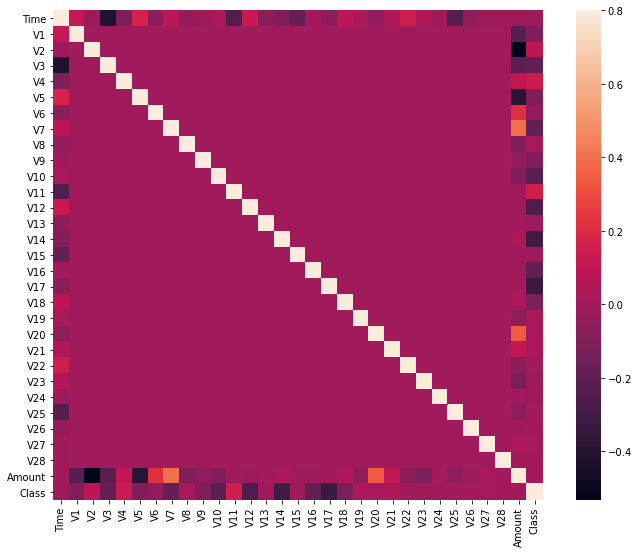

In [92]:
corrmat = df.corr()
fig = plt.figure(figsize = (12,9))
sns.heatmap(corrmat,vmax = 0.8, square = True)
plt.show()

PCA

In [62]:
from sklearn.decomposition import PCA

pca = PCA(n_components = 2)
X2D = pca.fit_transform(X)

X2D = pd.DataFrame(X2D,columns=['pca1','pca2'])

X2D['Class'] = df['Class']
print(pca.explained_variance_ratio_)

[0.2327403  0.10483706]


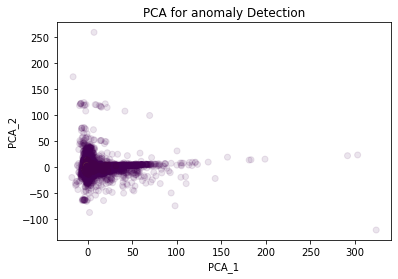

In [38]:
samp=X2D.sample(frac=1)

plt.scatter(samp['pca1'],samp['pca2'],c=samp['Class'],alpha=0.1);
plt.title('PCA for anomaly Detection');
plt.xlabel('PCA_1');
plt.ylabel('PCA_2');

<b> So there is no clear region where we can see the Fraud points in 2 dimension </b>

In [39]:
from sklearn.decomposition import PCA

pca=PCA(n_components = 3)
X3D = pca.fit_transform(X)

X3D = pd.DataFrame(X3D, columns=['pca1','pca2','pca3'])
X3D['Class']=df['Class']

samp=X3D.sample(frac=1)

import plotly.express as px

fig = px.scatter_3d(samp, x='pca1', y='pca2', z='pca3', color='Class')
fig.show()

We do see a small patch of anomaly but there are not well seperated with lot of overlap with normal points

In [71]:
X=df.drop('Class',axis = 1)
y =df['Class'].values
X_train, X_test, y_train,Y_test = train_test_split(X,y,test_size = 0.2,random_state = 42)

print(X)
print("Shape of X_train", X_train.shape)
print("Shape of X_test", X_test.shape)

            Time        V1        V2        V3        V4        V5        V6  \
0            0.0 -0.616237 -0.098602  1.228905  0.878152 -0.217859  0.631245   
1            0.0  0.524929  0.143100 -0.006970  0.293974  0.087726  0.164395   
2            1.0 -0.615587 -1.002407  0.830932  0.251024 -0.344345  1.778007   
3            1.0 -0.440239 -0.178789  0.841250 -0.529808  0.033775  1.303832   
4            2.0 -0.526089  0.579239  0.713861  0.265632 -0.270695  0.317183   
...          ...       ...       ...       ...       ...       ...       ...   
284802  172786.0 -5.321622  7.135767 -5.222589 -1.285699 -4.073679 -1.999082   
284803  172787.0 -0.335820 -0.085979  0.967471 -0.451476  0.707747  1.142041   
284804  172788.0  0.850377 -0.261532 -1.788463 -0.337932  2.059687  2.832770   
284805  172788.0 -0.115629  0.331602  0.272567  0.445763 -0.248270  0.769496   
284806  172792.0 -0.246654 -0.182004  0.272998 -0.305547  0.032059 -0.321743   

              V7         V8        V9  

In [83]:
from sklearn.ensemble import IsolationForest
from sklearn .metrics import accuracy_score, f1_score, confusion_matrix, plot_confusion_matrix, classification_report

outlier_fraction = fraud_count/float(nonfraud_count)
clf=IsolationForest(max_samples = len(X_train), contamination = outlier_fraction, random_state = 1)
clf.fit(X)
y_pred = clf.predict(X)

y_pred[y_pred == 1] = 0 #Non-Fraud Transactions
y_pred[y_pred == -1] = 1 #Fraud

print("Accuracy Score: {}".format(accuracy_score(y, y_pred)))
print(classification_report(y, y_pred))


C:\Users\prach\anaconda3\lib\site-packages\sklearn\base.py:441: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names

C:\Users\prach\anaconda3\lib\site-packages\sklearn\base.py:441: UserWarning:

X does not have valid feature names, but IsolationForest was fitted with feature names



Accuracy Score: 0.9977563753699874
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    284315
           1       0.35      0.35      0.35       492

    accuracy                           1.00    284807
   macro avg       0.67      0.68      0.68    284807
weighted avg       1.00      1.00      1.00    284807



In [5]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Gaussian Mixture

In [6]:
from sklearn.mixture import GaussianMixture
gm = GaussianMixture(n_components=3, n_init=10)
gm.fit(X_scaled)

GaussianMixture(n_components=3, n_init=10)